# Fetch Data Analysis
Andrew Fessler | February 2025


---

Using Google colab notebook environment, duckDB & dbt to clean/model, pandas to explore/QA, Altair & Superset to visualize.

In [ ]:
import duckdb
import pandas as pd
import numpy as np

## First: Review Existing Unstructured Data and Diagram a New Structured Relational Data Model

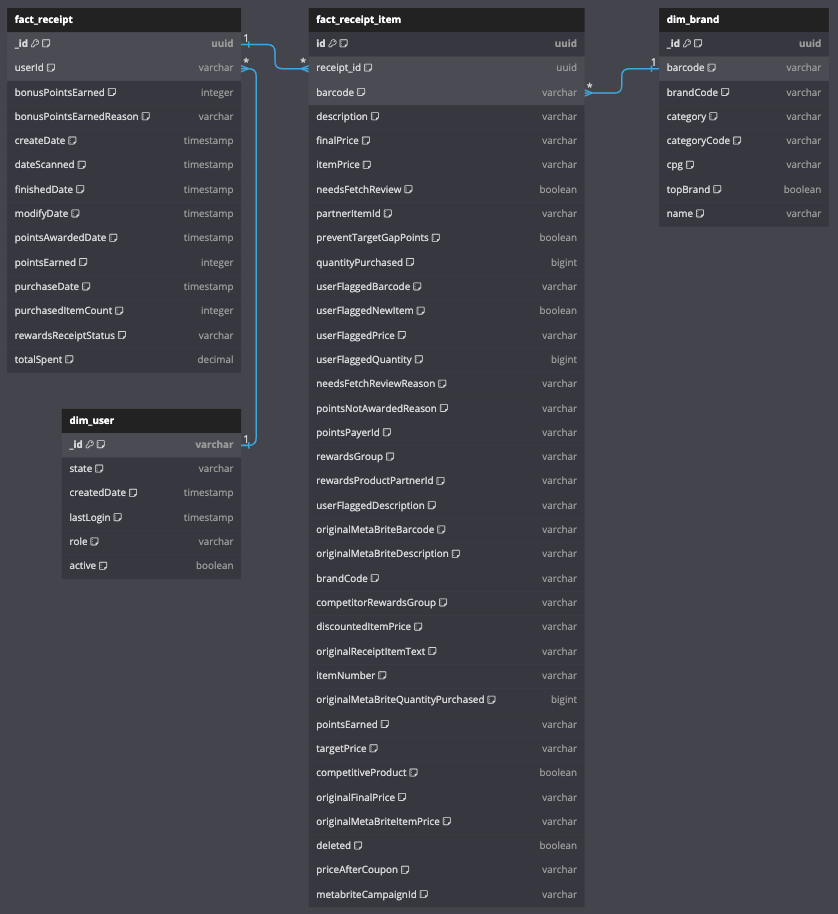




// Navigate to https://dbdiagram.io/d and copy paste code below to recreate image:
```
// Receipts Data Schema
Table fact_receipt {
  receipt_id uuid [primary key, note: 'Unique identifier for the receipt']
  userId varchar [note: 'References Users table']
  bonusPointsEarned integer [note: 'Bonus points awarded upon receipt completion']
  bonusPointsEarnedReason varchar [note: 'Event that triggered bonus points']
  createDate timestamp [note: 'Event creation date']
  dateScanned timestamp [note: 'Date the receipt was scanned']
  finishedDate timestamp [note: 'Date the receipt finished processing']
  modifyDate timestamp [note: 'Event modification date']
  pointsAwardedDate timestamp [note: 'Date points were awarded for the transaction']
  pointsEarned integer [note: 'Points earned for the receipt']
  purchaseDate timestamp [note: 'Date of the purchase']
  purchasedItemCount integer [note: 'Number of items on the receipt']
  rewardsReceiptStatus varchar [note: 'Status of the receipt validation/processing']
  totalSpent decimal [note: 'Total amount spent on the receipt']
}

// Receipt Items Data Schema (Derived from rewardsReceiptItemList in receipts)
Table fact_receipt_item {
  receipt_item_id uuid [primary key, note: 'Unique identifier for the receipt item']
  receipt_id uuid [note: 'References Receipts table']
  barcode varchar [note: 'Barcode of the purchased item']
  description varchar [note: 'Description of the purchased item']
  finalPrice varchar [note: 'Final price after discounts']
  itemPrice varchar [note: 'Original item price']
  needsFetchReview boolean [note: 'Flag indicating if Fetch review is required']
  partnerItemId varchar [note: 'Partner item ID']
  preventTargetGapPoints boolean [note: 'Flag to prevent target gap points']
  quantityPurchased bigint [note: 'Quantity of items purchased']
  userFlaggedBarcode varchar [note: 'User-flagged barcode']
  userFlaggedNewItem boolean [note: 'User-flagged new item']
  userFlaggedPrice varchar [note: 'User-flagged price']
  userFlaggedQuantity bigint [note: 'User-flagged quantity']
  needsFetchReviewReason varchar [note: 'Reason for Fetch review']
  pointsNotAwardedReason varchar [note: 'Reason points were not awarded']
  pointsPayerId varchar [note: 'ID of points payer']
  rewardsGroup varchar [note: 'Rewards group']
  rewardsProductPartnerId varchar [note: 'Rewards product partner ID']
  userFlaggedDescription varchar [note: 'User-flagged description']
  originalMetaBriteBarcode varchar [note: 'Original MetaBrite barcode']
  originalMetaBriteDescription varchar [note: 'Original MetaBrite description']
  brandCode varchar [note: 'Brand code associated with the item']
  competitorRewardsGroup varchar [note: 'Competitor rewards group']
  discountedItemPrice varchar [note: 'Discounted item price']
  originalReceiptItemText varchar [note: 'Original receipt item text']
  itemNumber varchar [note: 'Item number']
  originalMetaBriteQuantityPurchased bigint [note: 'Original MetaBrite quantity purchased']
  pointsEarned varchar [note: 'Points earned for the item']
  targetPrice varchar [note: 'Target price']
  competitiveProduct boolean [note: 'Flag for competitive product']
  originalFinalPrice varchar [note: 'Original final price']
  originalMetaBriteItemPrice varchar [note: 'Original MetaBrite item price']
  deleted boolean [note: 'Flag indicating if the item was deleted']
  priceAfterCoupon varchar [note: 'Price after coupon was applied']
  metabriteCampaignId varchar [note: 'MetaBrite campaign ID']
}

// Users Data Schema
Table dim_user {
  _id varchar [primary key, note: 'Unique identifier for the user']
  state varchar [note: 'State abbreviation']
  createdDate timestamp [note: 'Account creation date']
  lastLogin timestamp [note: 'Last login date']
  role varchar [default: 'CONSUMER', note: 'Role of the user']
  active boolean [note: 'Indicates if the user account is active']
}

// Brand Data Schema
Table dim_brand {
  _id uuid [primary key, note: 'Unique identifier for the brand']
  barcode varchar [note: 'Barcode on the item']
  brandCode varchar [note: 'Code corresponding to a partner product file']
  category varchar [note: 'Category name of products sold by the brand']
  categoryCode varchar [note: 'Category code referencing BrandCategory']
  cpg varchar [note: 'Reference to CPG collection']
  topBrand boolean [note: 'Indicates if the brand is a top brand']
  name varchar [note: 'Name of the brand']
}

// Relationships
Ref: fact_receipt.userId > dim_user._id // Many-to-One: A receipt belongs to one user
Ref: fact_receipt_item.receipt_id > fact_receipt._id // Many-to-One: Receipt items belong to a receipt
Ref: fact_receipt_item.barcode > dim_brand.barcode // Many-to-One: Receipt items reference a brand by brand code


```


I used dbt to build my models (see repo), but I have included the compiled queries here as well.

In [ ]:
dim_user_query = \
"""
select distinct columns(*) from (
    select
        * replace (
            _id."$oid" as _id,
            epoch_ms(createddate."$date") as createddate,
            epoch_ms(lastlogin."$date") as lastlogin
        )
    from
        read_json(
            'https://fetch-hiring.s3.amazonaws.com/analytics-engineer/ineeddata-data-modeling/users.json.gz',
            format = 'newline_delimited',
            ignore_errors = True
        )
)
where _id is not Null
;"""

dim_brand_query = \
"""
select
    * replace (trim(brandCode) as brandCode),
    _id."$oid" as brand_id,
    cpg."$id"."$oid" as cpg_oid,
    cpg."$ref" as cpg_ref
from
    read_json(
        'https://fetch-hiring.s3.amazonaws.com/analytics-engineer/ineeddata-data-modeling/brands.json.gz',
        format = 'newline_delimited',
        ignore_errors = True
    )
where brandCode not like 'TEST%'

"""
fact_receipt_item_query = \
"""
with receipt_base as (
    select
        _id."$oid" as receipt_id,
        purchasedItemCount,
        epoch_ms(createdate."$date")::timestamp as createdate,
        epoch_ms(datescanned."$date")::timestamp as datescanned,
        epoch_ms(finisheddate."$date")::timestamp as finisheddate,
        epoch_ms(modifydate."$date")::timestamp as modifydate,
        epoch_ms(pointsawardeddate."$date")::timestamp as pointsawardeddate,
        epoch_ms(purchasedate."$date")::timestamp as purchasedate,
        pointsearned::float as total_receipt_points_earned,
        totalspent::float as total_receipt_spent,
        unnest(coalesce(rewardsReceiptItemList,'[{}]'), recursive := true)
    from read_json('https://fetch-hiring.s3.amazonaws.com/analytics-engineer/ineeddata-data-modeling/receipts.json.gz',format='newline_delimited', ignore_errors=True)
)
select
* replace (itemPrice::decimal(8,2) as itemPrice),
receipt_id || '_' || row_number() over (partition by receipt_id order by barcode) as receipt_item_id,
sum(quantityPurchased) over (partition by receipt_id) as items_in_receipt_list,
sum(quantityPurchased) over (partition by receipt_id) - purchasedItemCount as summary_list_difference_count
from receipt_base

"""
fact_receipt_query = \
"""
select _id as receipt_id, * EXCLUDE (_id) from (
    select
        * replace (
            _id."$oid" as _id,
            epoch_ms(createdate."$date")::timestamp as createdate,
            epoch_ms(datescanned."$date")::timestamp as datescanned,
            epoch_ms(finisheddate."$date")::timestamp as finisheddate,
            epoch_ms(modifydate."$date")::timestamp as modifydate,
            epoch_ms(pointsawardeddate."$date")::timestamp as pointsawardeddate,
            epoch_ms(purchasedate."$date")::timestamp as purchasedate,
            pointsearned::float as pointsearned,
            totalspent::float as totalspent
        )
    from
        read_json(
            'https://fetch-hiring.s3.amazonaws.com/analytics-engineer/ineeddata-data-modeling/receipts.json.gz',
            format = 'newline_delimited',
            ignore_errors = True
        )
)

"""

In [ ]:
# dataframes
df_dim_user = duckdb.query(dim_user_query).df()
df_dim_brand = duckdb.query(dim_brand_query).df()
df_fact_receipt = duckdb.query(fact_receipt_query).df()
df_fact_receipt_item = duckdb.query(fact_receipt_item_query).df()
df_dim_user

,_id,active,createddate,lastlogin,role,signUpSource,state
0,5ff1e1eacfcf6c399c274ae6,True,2021-01-03 15:25:30.554,2021-01-03 15:25:30.597,consumer,Email,WI
1,5ff1e1e8cfcf6c399c274ad9,True,2021-01-03 15:25:28.354,2021-01-03 15:25:28.392,consumer,Email,WI
2,5ff1e1b7cfcf6c399c274a5a,True,2021-01-03 15:24:39.626,2021-01-03 15:24:39.665,consumer,Email,WI
3,5ff1e1b4cfcf6c399c274a54,True,2021-01-03 15:24:36.410,2021-01-03 15:24:36.452,consumer,Email,WI
4,5ff36c8862fde912123a538a,True,2021-01-04 19:29:12.943,2021-01-04 19:29:13.141,consumer,Email,WI
...,...,...,...,...,...,...,...
207,60268c7aefa6011bb1510786,True,2021-02-12 14:11:06.240,2021-02-12 14:11:06.294,consumer,Email,WI
208,60268c69efa6011bb151075f,True,2021-02-12 14:10:49.408,2021-02-12 14:12:07.107,consumer,Email,WI
209,5fbc35711d967d1222cbfefc,True,2020-11-23 22:19:29.509,2021-02-26 04:25:51.057,fetch-staff,Email,None
210,5fa41775898c7a11a6bcef3e,True,2020-11-05 15:17:09.396,2021-03-04 16:02:02.026,fetch-staff,Email,None


## Second: Write queries that directly answer predetermined questions from a business stakeholder


I have built views
```
v_brand_summary_history
v_alt_brand_summary_history
v_brand_status_summary_history
v_rewards_status_summary
```
in dbt to answer the business questions, and charts in Superset and Altair to illustrate.

### What are the top 5 brands by receipts scanned for most recent month?



Assuming:
- most recent month means latest in the supplied dataset
- the items for March 2021 do not qualify (all are COMPLETE_NONPARTNER_RECEIPT that were REJECTED)


The top 5 brands`^%` by receipts scanned for February 2021 would be:


```

select * from v_brand_status_summary_history
where month_receipt_count_rank <= 5
order by  month_scanned, rewardsReceiptStatus, month_receipt_count_rank;

-->
1. MISSION
2. Viva
3. Totino's
4. Cookie
5. Yoplait
```
`^` ignore nulls

`%` the generic "BRAND" brandCode is replaced with the first word of the description

Assuming we ignore February 2021 as well, the top 5 brands in January 2021 would be:



```
select * from v_brand_summary_history
where month_receipt_count_rank <= 5
order by  month_scanned, month_receipt_count_rank;

-->
1. BEN AND JERRYS
2. FOLGERS
3. Pepsi
4. Kraft
5. KELLOGG'S

```

Attempting a dubious fuzzy join to get more matches gives the following for Febuary 2021:


```
select * from v_alt_brand_summary_history
where month_receipt_count_rank <= 5
order by  month_scanned, month_receipt_count_rank;

-->
BRAND
Capri Sun
MISSION
Viva
Planters
Gevalia
Heinz
Corn Nuts
Doritos
```





### How does the ranking of the top 5 brands by receipts scanned for the recent month compare to the ranking for the previous month?
They are higher ranked. Of those available, MISSION moved up 5 ranks:


```
select month_scanned,brand_name,"month_receipt_count_rank","receipt_count_rank_change_mom"
from v_brand_summary_history
where brand_name in (select brand_name
            from v_brand_summary_history
            where month_receipt_count_rank <=5
            and month_scanned = '2021-02-01')
order by month_scanned, month_receipt_count_rank;

-->

 month_scanned,brand_name,month_receipt_count_rank,receipt_count_rank_change_mom
2021-01-01	BRAND	  7	None
2021-01-01	MISSION	8	None
2021-02-01	BRAND	  2	5
2021-02-01	MISSION	3	5
2021-02-01	Viva	   4	None
```





### When considering average spend from receipts with 'rewardsReceiptStatus' of 'Accepted' or 'Rejected', which is greater?
### When considering total number of items purchased from receipts with 'rewardsReceiptStatus' of 'Accepted' or 'Rejected', which is greater?

Assuming:

- "Accepted" means rewardsReceiptStatus = finished AND deleted is not true AND points_awarded = true
- "Rejected" means rewardsReceiptStatus = rejected AND deleted is not true
- Time period is all time


Accepted is greater for both:

```
select * from v_rewards_status_summary
where ( rewardsReceiptStatus = 'FINISHED' and points_awarded = true)
    OR ( rewardsReceiptStatus = 'REJECTED')
    
-->
rewardsReceiptStatus points_awarded     avg_spend    sum_item_counts
FINISHED	          True	          1275.68	   1364581.0
REJECTED	          True              1.0	       484.0
REJECTED	          False	         5.88	      53.0
```




### Which brand has the most spend among users who were created within the past 6 months?

### Which brand has the most transactions among users who were created within the past 6 months?:


Assuming previous 6 months from month of measurement

BEN AND JERRYS has the most spend and is tied with MISSION for most transactions among users who were created in the past 6 months:
```

select * from (
select *,rank() over (order by spend desc) as rnk  from (
select brand_name, sum(user_within_last_6mo_total_spent) as spend, null as transactions
from v_brand_summary_history
where brand_name is not null
group by brand_name
)
union
select *,rank() over (order by transactions desc) as rnk  from (
select brand_name, null as spend, sum(user_within_last_6mo_total_transactions) as transactions
from v_brand_summary_history
where brand_name is not null and brand_name != 'BRAND'
group by brand_name)
) where rnk = 1
order by spend;

-->
brand_name, spend, transactions, rnk
BEN AND JERRYS,	1213.41,	None,	1
MISSION,	None,	17,	1
BEN AND JERRYS,	None,	17,	1

```



With alternative joining, Kraft actually has more transactions:
```

select * from (
select *,rank() over (order by spend desc) as rnk  from (
select brand_name, sum(user_within_last_6mo_total_spent) as spend, null as transactions
from v_alt_brand_summary_history
where brand_name is not null
group by brand_name
)
union
select *,rank() over (order by transactions desc) as rnk  from (
select brand_name, null as spend, sum(user_within_last_6mo_total_transactions) as transactions
from v_alt_brand_summary_history
where brand_name is not null and brand_name != 'BRAND'
group by brand_name)
) where rnk = 1
order by spend;

-->
brand_name, spend, transactions, rnk
BEN AND JERRYS,	1157.43,	None,	1
Kraft,	None,	20,	1

```

In [ ]:
import altair as alt
alt.data_transformers.disable_max_rows()

# total spend by date scanned
alt.Chart(data=df_fact_receipt_item).mark_bar().encode(
    x='datescanned:T',
    y='sum(total_receipt_spent):Q',
    tooltip=['datescanned','sum(total_receipt_spent)']
).properties(width=900)

alt.Chart(...)

In [ ]:
alt.Chart(data=df_fact_receipt).mark_point().encode(
    x=alt.X('pointsearned').scale(type="symlog"),
    y=alt.Y('totalspent').scale(type="symlog"),
    color = 'rewardsReceiptStatus'
)

alt.Chart(...)

In [67]:
# distribution of scan to points awarded
df_fact_receipt['minutes_diff'] = (df_fact_receipt.pointsawardeddate - df_fact_receipt.datescanned) / pd.Timedelta(minutes=1)

alt.Chart(data=df_fact_receipt).transform_window(
       ecdf="cume_dist()",
    sort=[{"field": "minutes_diff"}],
).mark_line().encode(
    x=alt.X("minutes_diff:Q").scale(type='symlog'),
    y=alt.Y("ecdf:Q").scale(type="log"),

).interactive()


alt.Chart(...)

## Third: Evaluate Data Quality Issues in the Data Provided
Using the programming language of your choice (SQL, Python, R, Bash, etc...) identify as many data quality issues as you can. We are not expecting a full blown review of all the data provided, but instead want to know how you explore and evaluate data of questionable provenance.

Commit your code and findings to the git repository along with the rest of the exercise.

In [68]:
import sys
!{sys.executable} -m pip -q install -U ydata-profiling[notebook]
!pip -q install jupyter-contrib-nbextensions

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 9.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 31.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 8.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.9/390.9 kB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 87.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.2/117.2 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 67.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 62.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.1/69.1 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 385.8/385.8 kB 26.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.5/133.5 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.7/59.7 kB 4.6 MB/s eta 0:00:00
   ━━

In [69]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json
Paths used for configuration of notebook: 
    	
      - Validating: OK
Paths used for configuration of notebook: 
    	/root/.jupyter/nbconfig/notebook.json


In [70]:
from ydata_profiling import ProfileReport

In [71]:

profile_df_dim_user = ProfileReport(df_dim_user, title="dim_user Profiling Report")
profile_df_dim_brand = ProfileReport(df_dim_brand, title="dim_brand Profiling Report")
profile_df_fact_receipt = ProfileReport(df_fact_receipt, title="fact_receipt Profiling Report")
profile_df_fact_receipt_item = ProfileReport(df_fact_receipt_item, title="fact_receipt_item Profiling Report")



In [72]:
# save profile data to HTML to review

# Already included in the repo (fetch_data_analysis/data_quality/)
profile_df_dim_user.to_file("dim_user_report.html")
profile_df_dim_brand.to_file("dim_brand_report.html")
profile_df_fact_receipt.to_file("fact_receipt_report.html")
profile_df_fact_receipt_item.to_file("fact_receipt_item_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]
/usr/local/lib/python3.11/dist-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]
/usr/local/lib/python3.11/dist-packages/pandas/core/nanops.py:1632: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  return spearmanr(a, b)[0]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Fourth: Communicate with Stakeholders
Construct an email or slack message that is understandable to a product or business leader who isn't familiar with your day to day work. This part of the exercise should show off how you communicate and reason about data with others. Commit your answers to the git repository along with the rest of your exercise.

- What questions do you have about the data?

- How did you discover the data quality issues?

- What do you need to know to resolve the data quality issues?

- What other information would you need to help you optimize the data assets you're trying to create?

- What performance and scaling concerns do you anticipate in production and how do you plan to address them?

Hey Wes and team,

I've taken an initial look at the datasets you provided:

**Assumptions**

I assume this is a sample of data from a larger set, given that there are mostly users from Wisconsin and the majority of scans happened in January and February of 2021. I assume we are primarily interested in analyzing the performance of known partner brands, although other receipt data could be relevant and useful for others.

**Findings**

In terms of data quality, there are several areas of concern:
1. The user dataset contains duplicates for a large number of users. Additionally, it contains Fetch Staff user accounts-- unless we need to include them, I have removed them from analysis.
2. The values for some of the receipts are not stored in data types one would expect for a few fields, e.g. `TotalSpent` is stored as a string. We should discuss if we expect this to ever be anything other than a dollar value or null so we can handle it accordingly.
3. The brand data seems sparse-- I did the best I could to match it with the receipt data, but a low percentage have matched on `brandCode`/`barcode`. Additionally, some of the barcodes seem to be the same as the `brandCode` (mostly magazines and health & wellness items it seems) as well as the `ItemNumber`. I'll commit to documenting cross-system synonymous fields in our data docs if someone can explain so it's clear going forward.
4. Regarding barcodes specifically, there is a mix of GTIN, UPC, PLU, and ASIN barcodes. Luckily for the most common (GTIN-12) the checksums seem correct.

**Questions**

- What percentage of matched `barcode` / `brandCode` is typical?
- Are the largest transactions (4k+ spent, 600+ items) within the normal distribution, or should receipts like this be dropped or at least marked as an outlier of some sort?
- Who on the team is in charge of the format/schema of the JSON files we received? What is the process of getting something changed or added? How often is it changed?


**Recommendations**

There are other things to address (e.g. test barcodes/brands, special characters, data profiling results) but the above issues need to be handled first so we can get more robust insights -- the comparison for different months won't be meaningful without a full dataset, unless there is a different focus of understanding for this data (e.g. testing new technology, detecting fraud, general reporting, etc.). I've kept the data modeling flexible, however, fuzzy logic to do matching of brands to receipts will not scale, so it is important that we keep the brand data up-to-date and/or have access to an API to fetch fresh barcodes and load into the database.


If anyone would like to look at the data profile reports for more details, please check the link [here](https://github.com/AF414/fetch/data_quality/), or just reply to this email with the dataset(s) you are interested in seeing.


Thanks and have a nice week!

Best regards,
Andrew